In [12]:
%run 'config.ipynb'

config = Config({
    'tmp_folder' : '/var/shared/hist_project/Data/tmp',
    'level2_folder' : '/var/shared/hist_project/Data/Level2',
})

print(config)
print("\nNote: if you change the config file you need to restart the notebook for it to take effect")


Config:
tmp_folder	/var/shared/hist_project/Data/tmp
level2_folder	/var/shared/hist_project/Data/Level2

Note: if you change the config file you need to restart the notebook for it to take effect


In [13]:
%run 'ImageReader.ipynb'

print 'ImageReader loaded, use ImageReader.open(path, type=png\tiff), FrameCountCache(reader_list).dict'

ImageReader loaded, use ImageReader.open(path, type=png	iff), FrameCountCache(reader_list).dict


In [14]:
import os;

import os
from openslide import OpenSlide as op
import numpy as np
from matplotlib import pyplot as plt
import time

def slide_to_patches(input_svs, out_folder, target_mpp, tile_size=(224,224), verbose=False, 
                     img_format='tiff', max_patches_per_slide=100, seed=None):
        from PIL import TiffImagePlugin
        from PIL import Image
        import PIL
        import random
        import os
        import shutil
        import ast
        import itertools
        
        def transparent_to_white(cur_img):
            # Replace transparent background (from slide slicing) with white background
            canvas = Image.new('RGBA', cur_img.size, (220,220,220,255)) # Empty canvas colour (r,g,b,a)
            canvas.paste(cur_img, mask=cur_img) # Paste the image onto the canvas, using it's alpha channel as mask
            canvas.thumbnail([cur_img.width, cur_img.height], Image.ANTIALIAS)
            return canvas
        def on_error_return(img_reader):
            if img_reader.exists():
                print 'delete'
                img_reader.delete()
            return []
        
        if seed:
            random.seed(seed)
        
        if not os.path.isfile(input_svs):
            print "File not found: {}".format(input_svs)
            raise
        if img_format not in ('tiff', 'png'):
            print 'Unknown format: %s' % img_format
            raise
        
        slide_name = os.path.basename(input_svs)[:-4]
        out_filename = slide_name if img_format=='png' else (slide_name+'.tif')
        img_reader = ImageReader.open(out_folder+'/'+out_filename, type=img_format)
        
        if img_reader.exists():
            # Exists
            exists_frames = img_reader.n_frames()
            if (exists_frames==0) or (target_mpp != ast.literal_eval(img_reader.load_frame_meta(0)['mpp'])):
                # Different mpp
                img_reader.delete()
                loc_exists = set()
                exists_frames = 0
            else:
                # Same mpp & at least 1 frame
                max_patches_per_slide -= exists_frames
                loc_exists = set([img_reader.load_frame_meta(i)['location'] for i in range(exists_frames)])
        else:
            # Doesn't exist
            loc_exists = set()
            exists_frames = 0
        
        if max_patches_per_slide <= 0: # Skip if patched already
            if verbose:
                print 'slide already patched, skipping: %s' % input_svs
            return []
        
        slide = op(input_svs) # Open slide, this is the slow part
    
        if slide.detect_format(input_svs) == 'aperio':
            #print 'Format error on %s' % input_svs  # doesn't throw error, ok?\n",
            assert TypeError
        if 'aperio.MPP' not in slide.properties:
            print 'No mpp for slide, skipping: %s' % input_svs
            return on_error_return(img_reader)
        if len(slide.level_downsamples) == 0:
            print 'Slide with level_downsamples 0! %s' % input_svs
            return on_error_return(img_reader)
        
        slide_mpp =  float(slide.properties['aperio.MPP'])
        if verbose:
            print 'slide mpp: %f' % slide_mpp
        
        if target_mpp < slide_mpp:
            print 'Slide mpp: %f, Target mpp: %f, skipping: %s' % (slide_mpp, target_mpp, input_svs)
            return on_error_return(img_reader)
        
        factor_mpp =  target_mpp / slide_mpp # e.g 20x->40x : 1/(1 / 0.25) = 0.25 (need to take quarter the size of the patch)
        
        dim = slide.dimensions
        tile_size_level_0 = ((int)(factor_mpp*tile_size[0]),(int)(factor_mpp*tile_size[1]))
        
        avail_levels = [i for i, ds in enumerate(slide.level_downsamples) if slide_mpp*ds<=target_mpp]
        if len(avail_levels) == 0:
            print 'No avail levels: %s' % input_svs
            return on_error_return(img_reader)
        
        target_level = max(avail_levels)
        target_factor_mpp = target_mpp / (slide.level_downsamples[target_level] * slide_mpp)
        tile_size_level_target = ((int)(target_factor_mpp*tile_size[0]),(int)(target_factor_mpp*tile_size[1]))
        
        if verbose:
            print 'level 0: %s' % str(tile_size_level_0)
            print 'pull from level %d: %s' % (target_level, str(tile_size_level_target)) 
            
        smallest_level = len(slide.level_downsamples) - 1
        tile_size_smallest_factor = slide.level_downsamples[-1]
        tile_size_smallest = ((int) (tile_size_level_0[0] / tile_size_smallest_factor), (int) (tile_size_level_0[1] / tile_size_smallest_factor) )
    
        col_loc = range(0,dim[0],tile_size_level_0[0])
        row_loc = range(0,dim[1],tile_size_level_0[1])
    
        all_locs = list(itertools.product(col_loc, row_loc)) # cartesian product
    
        random.shuffle(all_locs)
        
        mean_list=[]
        img_list = []
        for (i,j) in all_locs:
            if len(img_list) >= max_patches_per_slide:
                break
            if str((i,j)) in loc_exists:
                continue
                
            samp_image = slide.read_region(location=(i,j), level=smallest_level, size=tile_size_smallest)
            canvas = transparent_to_white(samp_image)
                
            cur_img_avg = np.mean(np.array(canvas))
            mean_list.append(cur_img_avg)
            if  cur_img_avg <= 220:
                #if slide_mpp < target_mpp: # take level_wis, resize to fit
                cur_img = slide.read_region(location=(i,j), level=target_level, size=tile_size_level_target)
                cur_img = cur_img.resize(size=tile_size)
                canvas = transparent_to_white(cur_img)
                    
                canvas.info = {'location':str((i,j)), 'tile-size-level-0':str(tile_size_level_0),'mpp':str(target_mpp)}

                img_list.append(canvas)
        
        if len(img_list) > 0:
            if img_format=='tiff':
                from PIL.TiffImagePlugin import ImageFileDirectory_v2
                PIL.TiffImagePlugin.WRITE_LIBTIFF = False
                PIL.TiffImagePlugin.DEBUG = False

                tiff_full_filename = out_folder+'/'+out_filename
                is_create_new_file = not img_reader.exists()
                with TiffImagePlugin.AppendingTiffWriter(tiff_full_filename,is_create_new_file) as tf:
                    for img in img_list:
                        tags = ImageFileDirectory_v2()
                        tags[270] = str(img.info)                                  # PIL.TiffTags.TAGS_V2 270 -> Description
                        img.save(tf, tiffinfo=tags)                                # quicker, more space
                        #img.save(tf, compression='tiff_deflate', tiffinfo=tags)   # slower, less space, does not support adding tiffinfo!!!

                        tf.newFrame()
            elif img_format=='png':
                from PIL import PngImagePlugin

                png_dir_full = out_folder+'/'+out_filename
                if not os.path.exists(png_dir_full):
                    os.mkdir(png_dir_full)  
                reserved = set(['interlace', 'gamma', 'dpi', 'transparency', 'aspect'])
                for frame_id, img in enumerate(img_list):
                    # undocumented class
                    meta = PngImagePlugin.PngInfo()

                    # copy metadata into new object
                    for k,v in img.info.iteritems():
                        if k in reserved: continue
                        meta.add_text(k, v, 0)

                    file_name = '%d.png' % (frame_id+exists_frames)
                    img.save(fp=png_dir_full+'/'+file_name,format='png',compress_level=4,pnginfo=meta)  #compression (0,9). Default 6. 9=highest & slowest
        #else:
        #    print 'No patches pass threshold: %s' % input_svs
        #    return on_error_return(img_reader)
        random.seed(None)
        return mean_list

#input_svs = '/var/shared/zelda-tcga/ad3f7a87-83bf-48bd-b3d9-cb9b34ef7e74/TCGA-A1-A0SG-01A-01-TS1.5f26a16f-7657-4383-8c5e-48c62cc2e258.svs'
#input_svs = '/var/shared/zelda-tcga/31dc6f93-a5a5-4ce0-95e3-3c401492daa8/TCGA-FG-8186-01A-01-TS1.585159f5-b0ea-425d-bcb2-00c7c21d6158.svs'
#input_svs = '/var/shared/hist_project/Data/to_slice/Ectocervix/GTEX-N7MT-0825.svs'
#input_svs = '/var/shared/zelda-tcga/f668d695-3682-4bea-ab2f-1e320dc249b9/TCGA-AA-A029-01A-01-BS1.e5446960-f105-4548-97fd-2e6b3d82afa7.svs'
#input_svs = '/var/shared/zelda-tcga/720d07cb-36bf-48de-86ae-7973a45cacc0/TCGA-B0-5402-11A-01-TS1.40c61e94-a787-4972-8695-90d3558c18a9.svs'
#input_svs = '/var/shared/zelda-tcga/e288bc7d-7ce8-4f21-a3fa-db558d0d55d6/TCGA-KL-8330-01A-01-BS1.191e5013-1371-43f9-a9a2-c9bc09cbeaaf.svs'
#input_svs = '/var/shared/zelda-tcga/1fd8ba85-547b-435f-830e-a436746990fd/TCGA-3C-AALJ-01Z-00-DX1.777C0957-255A-42F0-9EEB-A3606BCF0C96.svs'
#input_svs = '/var/shared/zelda-tcga/cdbde7ab-3de0-40c9-a82c-0b40fba36a38/TCGA-S3-AA12-01Z-00-DX2.4F0A4F18-41C7-4497-A7B8-5DCE610E08AD.svs'
input_svs = '/var/shared/zelda-tcga/a32d95a7-66ec-441c-b40d-71b68adeb500/TCGA-A1-A0SK-01Z-00-DX1.A44D70FA-4D96-43F4-9DD7-A61535786297.svs'

#%time mean_list = slide_to_patches(input_svs, config.tmp_folder, target_mpp=1.0, img_format='tiff', max_patches_per_slide=500, seed=1, verbose=True)
#%time mean_list = slide_to_patches(input_svs, '/var/shared/hist_project/Data/patched_full/0.6mpp', target_mpp=0.6, img_format='png', max_patches_per_slide=50000, seed=1, verbose=True)

plt.hist(mean_list)
plt.show()

NameError: name 'mean_list' is not defined

In [ ]:
#from IPython.display import Image 
from PIL import Image

#img_filename = 'TCGA-A1-A0SG-01A-01-TS1.5f26a16f-7657-4383-8c5e-48c62cc2e258'
#img_filename = 'TCGA-FG-8186-01A-01-TS1.585159f5-b0ea-425d-bcb2-00c7c21d6158'
#img_filename = 'GTEX-N7MT-0825'
img_filename = 'TCGA-KL-8330-01A-01-BS1.191e5013-1371-43f9-a9a2-c9bc09cbeaaf'

png_dir = '/var/shared/hist_project/Data/tmp/%s/' % img_filename

tiff_filename = '/var/shared/hist_project/Data/tmp/%s.tif' % img_filename

%time tiff_img = Image.open(tiff_filename)

print(tiff_img.n_frames)

# Show both tiff & png (verify quality of tiff)
fig=plt.figure(figsize=(12, 12))
for i in range(0,3):
    fig.add_subplot(2,3,i+1)
    tiff_img.seek(i)
    plt.imshow(tiff_img)
    fig.add_subplot(2,3,i+4)
    plt.imshow(Image.open(png_dir+str(i)+'.png'))
plt.show()

/var/shared/zelda-tcga/a32d95a7-66ec-441c-b40d-71b68adeb500/TCGA-A1-A0SK-01Z-00-DX1.A44D70FA-4D96-43F4-9DD7-A61535786297.svs /var/shared/hist_project/Data/Level2/0.6mpp/TCGA/TCGA-A1-A0SK-01Z-00-DX1.A44D70FA-4D96-43F4-9DD7-A61535786297
0%....5%....10%....15%....20%....25%....30%....35%....40%....45%....50%....55%....60%....65%....70%....75%....80%....85%....90%....95%....100%


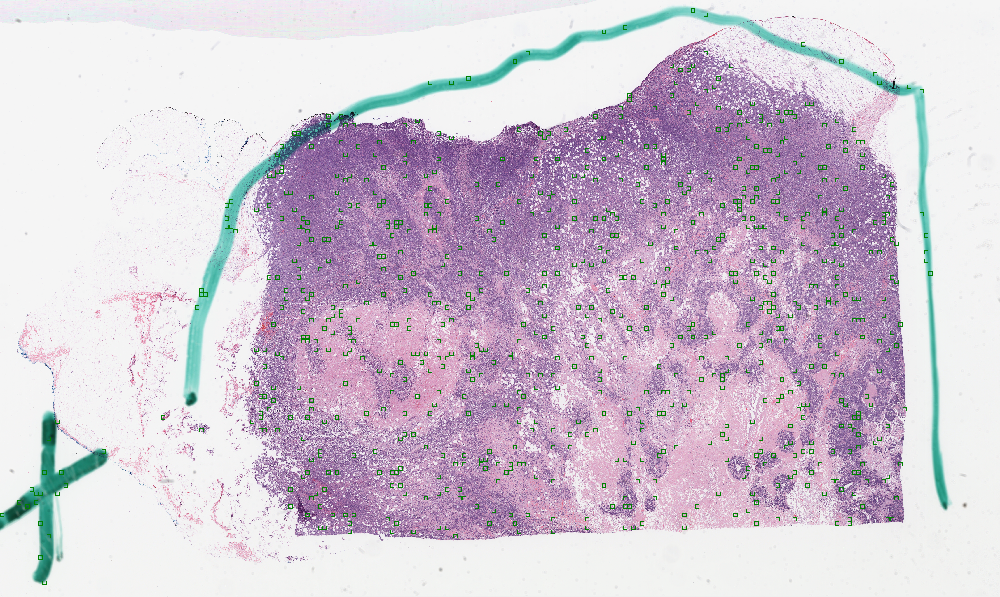

In [16]:
def progress_hook(count, total_size, progress=None):
    import sys
    percent = int(count * 100 / total_size)
    if progress != percent:
        if percent % 5 == 0:
            sys.stdout.write("%s%%" % percent)
            if (percent == 100):
                sys.stdout.write("\n"),
                sys.stdout.flush()
        else:
            sys.stdout.write(".")
            sys.stdout.flush()

    return percent

def plot_slide_patches(svs_filename, img_reader, debug=False):
    from openslide import OpenSlide as op
    from matplotlib import pyplot as plt
    from PIL import ImageDraw
        
    frames_meta = [img_reader.load_frame_meta(i) for i in range(img_reader.n_frames())]
        
    svs_slide = slide = op(svs_filename)
    slide_dim_0 = slide.dimensions
    
    thumb = svs_slide.get_thumbnail(size=(2560*3,1080*3))
    
    assert slide.level_downsamples[0] == 1.
    
    tile_size_dim_0 = eval(frames_meta[0]['tile-size-level-0'])
    
    resize_factor = (1.0 * slide_dim_0[0] / thumb.size[0], 1.0 * slide_dim_0[1] / thumb.size[1])
    tile_size_thumb = ((tile_size_dim_0[0] / resize_factor[1]), (tile_size_dim_0[1] / resize_factor[1]))
    
    if debug:
        print 'resize_factor: ' + str(resize_factor)
        print 'slide_dim_0: %s, tile_size_dim_0: %s' % (str(slide_dim_0), str(tile_size_dim_0))
        print 'thumb_dim: %s, thumb_tile_size: %s' % (str(thumb.size), str(tile_size_thumb))

    done = 0
    total = len(frames_meta)
    progress = progress_hook(done,total,None)
        
    draw = ImageDraw.Draw(thumb)
    for f_id, f_meta in enumerate(frames_meta):
        patch_dim_0_loc = eval(f_meta['location'])
        
        patch_loc = patch_dim_0_loc[0] / resize_factor[0], patch_dim_0_loc[1] / resize_factor[1]
        patch_end_loc = patch_loc[0] + tile_size_thumb[0], patch_loc[1] + tile_size_thumb[1]
        
        patch_loc = (int)(patch_loc[0]), (int)(patch_loc[1])
        patch_end_loc = (int)(patch_end_loc[0]), (int)(patch_end_loc[1])
        
        crop_area = (patch_loc[0], patch_loc[1], patch_end_loc[0], patch_end_loc[1]) #( left, top, right, bottom )
        
        rect_color = 'green'
        
        rect_width = 4
        
        for i in range(rect_width):
            draw.rectangle(xy=[(crop_area[0]+i,crop_area[1]+i),(crop_area[2]-i,crop_area[3]-i)], outline=rect_color)
        
        done += 1
        progress = progress_hook(done,total,progress)
    
    del draw
    #thumb.save('/var/shared/hist_project/Data/logs/%s.png' % img_reader.basename(),"PNG")
    return thumb

input_patched = config.level2_folder+'/0.6mpp/TCGA/' + os.path.basename(input_svs)[:-4]
#input_patched = '/var/shared/hist_project/Data/patched_full/0.6mpp/' + os.path.basename(input_svs)[:-4]
print input_svs, input_patched
plot_slide_patches(input_svs, ImageReader.open(input_patched, type='png'))

In [ ]:
from openslide import OpenSlide as op
        
slide = slide = op(input_svs)
slide_dim_0 = slide.dimensions
slide_mpp = float(slide.properties['aperio.MPP'])

print slide_dim_0, slide_mpp
print 0.6 / slide_mpp
x = slide.read_region(location=(0,0), level=0, size=slide_dim_0)

In [17]:
# Find list of files to slice

import pandas as pd
import distutils.dir_util

target_mpp = 0.6
group_name = 'TCGA'

def find_file_recursive(folder, file_ext='*.svs'):
    import fnmatch
    import os

    matches = []
    for root, dirnames, filenames in os.walk(folder, followlinks=True):
        for filename in fnmatch.filter(filenames, file_ext):
            matches.append(os.path.join(root, filename))
    return matches

def findnth(haystack, needle, n):
    """Find Nth occurance of string in another string"""
    parts= haystack.split(needle, n+1)
    if len(parts)<=n+1:
        return -1
    return len(haystack)-len(parts[-1])-len(needle)

def prepare_data(level1_folder, group):
    import os
    data = {}
    svs_files = find_file_recursive(level1_folder, '*.svs')
    for full_filename in svs_files:
        filename = os.path.basename(full_filename)
        if group not in filename:
            print 'file without case, skipping : %s' % filename
            continue
        if group=='TCGA':
            case_barcode = filename[:findnth(filename,'-',2)]
        elif group=='GTEX':
            case_barcode = filename[:findnth(filename,'-',1)]
        else:
            raise Error('Unknown group name %s' % group)
        patient_slides = data.get(case_barcode,[])
        patient_slides.append(full_filename)
        data[case_barcode] = patient_slides
    return data

def filenames_no_ext(fullname_list):
    return [filename_no_ext(f) for f in fullname_list]
def filename_no_ext(f):
    return os.path.basename(f)[:-4]

# Flatten function
flatten = lambda l: [item for sublist in l for item in sublist]

data = prepare_data('/var/shared/zelda-tcga', group_name)

print 'patients: %d, slides: %d' % (len(data), len(flatten(data.values())))

files_to_slice = flatten([data[k] for k in set(data.keys())])
print 'files to slice : %d' % len(files_to_slice)

out_folder = '%s/%.1fmpp/%s' % (config.level2_folder,target_mpp,group_name)
distutils.dir_util.mkpath(out_folder) # Create folders if missing

print out_folder

files_tiff_exist = os.listdir(out_folder)
files_tiff_exist = set(files_tiff_exist)
print 'patches exist (tif) : %d' % len(files_tiff_exist)

files_to_slice_new = files_to_slice # [f for f in files_to_slice if filename_no_ext(f) not in files_tiff_exist]
print 'delta to slice: %d' % len(files_to_slice_new)

patients: 9565, slides: 26150
files to slice : 26150
/var/shared/hist_project/Data/Level2/0.6mpp/TCGA
patches exist (tif) : 3096
delta to slice: 26150


In [18]:
import pandas as pd

hit_map = {}

to_patch_csv = pd.read_csv('/home/maor/to_patch_df.csv')

to_patch_csv = to_patch_csv.loc[to_patch_csv['PrimarySite']=='Breast']

to_patch_set = set(to_patch_csv['Slide_name'])
files_to_slice_filtered = []
for full_svs_file in files_to_slice_new:
    slide_name = os.path.basename(full_svs_file)[:-4]
    if slide_name in to_patch_set:
        files_to_slice_filtered.append(full_svs_file)
        if slide_name not in hit_map:
            hit_map[slide_name] = []
        hit_map[slide_name].append(full_svs_file)
        
dup_map = {k:v for k,v in hit_map.iteritems() if len(v)> 1}
print len(to_patch_set), len(files_to_slice_filtered)
#print dup_map # downloaded duplicate slides...
print 'Duplicate svs files: %d' % len(dup_map)

3096 3100
Duplicate svs files: 4


In [19]:
def calc_reinhard(input_svs, target_mpp):
    import histomicstk as htk

    def calc_magnification(input_svs, target_mpp):
        from openslide import OpenSlide as op

        slide = slide = op(input_svs)

        slide_mpp = float(slide.properties['aperio.MPP'])

        return target_mpp/slide_mpp
    
    magnification = calc_magnification(input_svs, target_mpp=0.6)
    target_mu, target_sigma = htk.preprocessing.color_normalization.reinhard_stats(input_svs, 0.05, magnification=magnification)
    return target_mu, target_sigma

calc_reinhard('/var/shared/zelda-tcga/e9a8a6b6-0fbf-41f4-a263-c04abd295a44/TCGA-A2-A0YT-01A-01-TSA.fbac252d-8ada-4379-826f-1f255b826280.svs',target_mpp=0.6)

(array([ 8.44503581, -0.08598043,  0.0534337 ]),
 array([0.64234333, 0.09501468, 0.03622178]))

In [ ]:
def calc_reinhard_dict(files_to_slice_new, reinhard_dict_file):
    import pickle
    
    try:
        reinhard_dict = pickle.load(open(reinhard_dict_file, "rb"))
    except (OSError, IOError) as e:
        reinhard_dict = {}
    
    total_to_slice = len(files_to_slice_new)
    
    print 'Total: %d' % total_to_slice
    
    for i, svs_file in enumerate(files_to_slice_new):
        print '%d....' % i,
        
        slide_key = filename_no_ext(svs_file)
        if slide_key in reinhard_dict:
            print 'skip'
            continue
        
        try:
            slide_reinhard = calc_reinhard(svs_file, target_mpp=0.6)
            reinhard_dict[slide_key] = slide_reinhard

            pickle.dump(reinhard_dict, open(reinhard_dict_file, "wb+"), pickle.HIGHEST_PROTOCOL) 
            print 'done'
        except Exception as e:
            print 'ERROR'
    
calc_reinhard_dict(files_to_slice_filtered, '/var/shared/hist_project/Data/tmp/full_reinhard_dict.dict')

 Total: 3100
0.... skip
1.... skip
2.... skip
3.... skip
4.... skip
5.... skip
6.... skip
7.... skip
8.... skip
9.... skip
10.... skip
11.... skip
12.... skip
13.... skip
14.... skip
15.... skip
16.... skip
17.... skip
18.... skip
19.... skip
20.... skip
21.... skip
22.... skip
23.... skip
24.... skip
25.... skip
26.... skip
27.... skip
28.... skip
29.... skip
30.... skip
31.... skip
32.... skip
33.... skip
34.... skip
35.... skip
36.... skip
37.... skip
38.... skip
39.... skip
40.... skip
41.... skip
42.... skip
43.... skip
44.... skip
45.... skip
46.... skip
47.... skip
48.... skip
49.... skip
50.... skip
51.... skip
52.... skip
53.... skip
54.... skip
55.... skip
56.... skip
57.... skip
58.... skip
59.... skip
60.... skip
61.... skip
62.... skip
63.... skip
64.... skip
65.... skip
66.... skip
67.... skip
68.... skip
69.... skip
70.... skip
71.... skip
72.... skip
73.... skip
74.... skip
75.... skip
76.... skip
77.... skip
78.... skip
79.... skip
80.... skip
81.... skip
82.... skip
8

637.... done
638.... done
639.... done
640.... done
641.... done
642.... done
643.... done
644.... done
645.... done
646.... done
647.... done
648.... done
649.... done
650.... done
651.... done
652.... done
653.... done
654.... done
655.... done
656.... done
657.... done
658.... done
659.... done
660.... done
661.... done
662.... done
663.... done
664.... done
665.... done
666.... done
667.... done
668.... done
669.... done
670.... done
671.... done
672.... done
673.... done
674.... done
675.... done
676.... done
677.... done
678.... done
679.... done
680.... done
681.... done
682.... done
683.... done
684.... done
685.... done
686.... done
687.... done
688.... done
689.... done
690.... done
691.... done
692.... done
693.... done
694.... done
695.... done
696.... done
697.... done
698.... done
699.... done
700.... done
701.... done
702.... done
703.... done
704.... done
705.... done
706.... done
707.... done
708.... done
709.... done
710.... done
711.... done
712.... done
713.... done

/var/shared/miniconda2/envs/histo/lib/python2.7/site-packages/scipy/stats/_distn_infrastructure.py:1652: RuntimeWarning: divide by zero encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


 done
1048.... done
1049.... done
1050.... done
1051.... done
1052.... done
1053.... done
1054.... done
1055.... done
1056.... done
1057.... done
1058.... done
1059.... done
1060.... done
1061.... done
1062.... done
1063.... done
1064.... done
1065.... done
1066.... done
1067.... done
1068.... done
1069.... done
1070.... done
1071.... done
1072.... done
1073.... done
1074.... done
1075.... done
1076.... done
1077.... done
1078.... done
1079.... done
1080.... done
1081.... done
1082.... done
1083.... done
1084.... done
1085.... done
1086.... done
1087.... done
1088.... done
1089.... done
1090.... done
1091.... done
1092.... done
1093.... done
1094.... done
1095.... done
1096.... done
1097.... done
1098.... done
1099.... done
1100.... done
1101.... done
1102.... done
1103.... done
1104.... done
1105.... done
1106.... done
1107.... done
1108.... done
1109.... done
1110.... done
1111.... done
1112.... done
1113.... done
1114.... ERROR
1115.... done
1116.... done
1117.... done
1118.... done

1633.... done
1634.... done
1635.... done
1636.... done
1637.... done
1638.... done
1639.... done
1640.... done
1641.... done
1642.... done
1643.... done
1644.... done
1645.... done
1646.... done
1647.... done
1648.... done
1649.... done
1650.... done
1651.... done
1652.... done
1653.... done
1654.... done
1655.... done
1656.... done
1657.... done
1658.... done
1659.... done
1660.... done
1661.... done
1662.... done
1663.... done
1664.... done
1665.... done
1666.... done
1667.... done
1668.... done
1669.... done
1670.... done
1671.... done
1672.... done
1673.... done
1674.... done
1675.... done
1676.... done
1677.... done
1678.... done
1679.... done
1680.... done
1681.... done
1682.... done
1683.... done
1684.... done
1685.... done
1686.... done
1687.... done
1688.... done
1689.... done
1690.... done
1691.... done
1692.... done
1693.... done
1694.... done
1695.... done
1696.... done
1697.... done
1698.... done
1699.... done
1700.... done
1701.... done
1702.... done
1703.... done
1704..

INFO:root:OpenSlide has no small-scale tiles (level 0 is at 513 scale)


 ERROR
1997.... done
1998.... done
1999.... done
2000.... skip
2001.... done
2002.... done
2003.... done
2004.... done
2005.... done
2006.... done
2007.... done
2008.... done
2009.... done
2010.... done
2011.... done
2012.... done
2013.... done
2014.... done
2015.... done
2016.... done
2017.... done
2018.... done
2019.... done
2020.... done
2021.... done
2022.... done
2023.... done
2024.... done
2025.... done
2026.... done
2027.... done
2028.... done
2029.... done
2030.... done
2031.... done
2032.... done
2033.... done
2034.... done
2035.... done
2036.... done
2037.... done
2038.... done
2039.... done
2040.... done
2041.... done
2042.... done
2043.... done
2044.... done
2045.... done
2046.... done
2047.... done
2048.... done
2049.... done
2050.... done
2051.... done
2052.... done
2053.... done
2054.... done
2055.... done
2056.... done
2057.... done
2058.... done
2059.... done
2060.... done
2061.... done
2062.... done
2063.... done
2064.... done
2065.... done
2066.... done
2067.... done

In [7]:
def prepare_level2(files_to_slice_new, out_folder, max_workers):
    import random
    from concurrent.futures import ThreadPoolExecutor
    
    total_to_slice = len(files_to_slice_new)
    print 'preparing %d files: ' % total_to_slice
        
    with ThreadPoolExecutor(max_workers=max_workers) as executor:
        futures = []
        for svs_file in files_to_slice_new:
            f = executor.submit(slide_to_patches, \
                         svs_file, out_folder, target_mpp=0.6, tile_size=(224,224), verbose=False, \
                         img_format='png', max_patches_per_slide=800, seed=None)
            futures.append(f)

        done_count = 0
        progress = progress_hook(done_count, total_to_slice, None)
        for f in futures:
            try:
                f.result()
            except Exception as e:
                print svs_file
                print(e)

            done_count += 1
            progress = progress_hook(done_count, total_to_slice, progress)
    print("\n")

prepare_level2(files_to_slice_filtered, out_folder, max_workers=10)

preparing 3100 files: 


NameError: global name 'progress_hook' is not defined

In [ ]:
out_folder = '/var/shared/hist_project/Data/Level2/TCGA'
img_format = 'png'
def check_img_reader(img_reader):
    mpp = img_reader.load_frame_meta(0)['mpp']
    mpp = float(mpp)
    if mpp != 1.0:
        print input_svs
        raise
for input_svs in files_to_slice_new:
    slide_name = os.path.basename(input_svs)[:-4]
    out_filename = slide_name if img_format=='png' else (slide_name+'.tif')
    img_reader = ImageReader.open(out_folder+'/'+out_filename, type=img_format)
    if not img_reader.exists():
        continue
    check_img_reader(img_reader)

In [29]:
for slide_name in os.listdir(out_folder):
    out_filename = slide_name if img_format=='png' else (slide_name+'.tif')
    img_reader = ImageReader.open(out_folder+'/'+out_filename, type=img_format)
    if not img_reader.exists():
        continue
    check_img_reader(img_reader)

In [10]:
# Clean space on device
img_format = 'png'
for slide_name in os.listdir(out_folder):
    out_filename = slide_name if img_format=='png' else (slide_name+'.tif')
    frames = os.listdir(out_folder+'/'+slide_name)
    for f in frames:
        frame_id = int(f.replace(".png",""))
        if frame_id > 400:
            #print "Remove " + out_folder + "/" + slide_name + "/" + f
            #os.remove(out_folder + "/" + slide_name + "/" + f)
            pass

In [40]:
# Verify intergiry
img_format = 'png'
for slide_name in os.listdir(out_folder):
    out_filename = slide_name
    img_reader = ImageReader.open(out_folder+'/'+slide_name, type='png')
    frames = os.listdir(out_folder+'/'+slide_name)
    frame_ids = set([int(f.replace(".png","")) for f in frames])
    frame_count = len(frames)
    if frame_count != len(frames):
        print (out_folder + '/' + slide_name)
        raise
    for i in range(frame_count):
        if i not in frame_ids:
            print (out_folder + '/' + slide_name), i
            raise
        try:
            img_reader.load_frame(i)
        except IndexError as e:
            print img_reader.path, i, img_reader.n_frames()
            print e
            raise

KeyboardInterrupt: 

In [44]:
def check_img_reader(img_reader):
    print img_reader.n_frames()
    for i in range(img_reader.n_frames()):
        print str(i) + ' ',
        img_reader.load_frame(i)

img_reader_to_test = ImageReader.open('/var/shared/hist_project/Data/Level2/TCGA/TCGA-55-6978-01Z-00-DX1.2ef6d6aa-2a19-4bce-b845-cc83ac81a1c3', type='png')
check_img_reader( img_reader_to_test )

 399
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99  100  101  102  103  104  105  106  107  108  109  110  111  112  113  114  115  116  117  118  119  120  121  122  123  124  125  126  127  128  129  130  131  132  133  134  135  136  137  138  139  140  141  142  143  144  145  146  147  148  149  150  151  152  153  154  155  156  157  158  159  160  161  162  163  164  165  166  167  168  169  170  171  172  173  174  175  176  177  178  179  180  181  182  183  184  185  186  187  188  189  190  191  192  193  194  195  196  197  198  199  200  201  202  203  204  205  206  207  208  209  210  211  212  213  214  215  216  217  218  219  220  

In [ ]:
 Image.open(img_reader_to_test.path + '/' + str(141)+'.png')